# **Implementación de un prototipo de software para predecir complicaciones en pacientes en unidad de cuidados intensivos pediátricos (UCIP), a través de modelos de aprendizaje automático**

Importar librerías

In [ ]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt
import pandas as pd 
import seaborn as sns

from google.colab.data_table import DataTable

Importar base de datos

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
ucip = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/UCIP/dataset.csv')

In [ ]:
categorical_ucip = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/UCIP/Categorizada.xlsx')

In [ ]:
categorical_complete_ucip = pd.read_excel('/content/drive/MyDrive/Colab Notebooks/UCIP/CategorizadaCompleta.xlsx')

In [ ]:
ucip["Condition"] = categorical_ucip

In [ ]:
ucip = ucip.join(categorical_complete_ucip)

In [ ]:
ucip

,No. Patients,Age,Weight (Kg),Height (cms),Genero,Diagnosis,Outcome,Hour event (seconds),Heart Rate,oxygen saturation,...,Systolic Blood Pressure,"Diastolic Blood Pressure,",Mean Blood Pressure,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2 months,5.5,60.0,female,myocarditis,survived,18:52,138,92,...,100,56,73,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2 months,5.5,60.0,female,myocarditis,survived,18:53,142,92,...,99,53,69,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2 months,5.5,60.0,female,myocarditis,survived,18:54,139,92,...,99,52,68,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2 months,5.5,60.0,female,myocarditis,survived,18:55,142,92,...,97,51,66,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2 months,5.5,60.0,female,myocarditis,survived,18:56,144,92,...,102,56,71,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94673,90,6 months,8.0,67.0,male,bronchiolitis-prematurity-heart disease,dead,7:40,105,78,...,46,33,37,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94674,90,6 months,8.0,67.0,male,bronchiolitis-prematurity-heart disease,dead,7:41,105,78,...,46,33,37,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
94675,90,6 months,8.0,67.0,male,bronchiolitis-prematurity-heart disease,dead,7:42,40,60,...,0,0,0,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94676,90,6 months,8.0,67.0,male,bronchiolitis-prematurity-heart disease,dead,7:43,20,30,...,0,0,0,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO


Renombrar variables

In [ ]:
ucip = ucip.rename(columns={'No. Patients': 'Id', 'Hour event (seconds)': 'Time','Heart Rate': 'FC', 'oxygen saturation': 'SpO2', 'Respiratory Rate': 'FR', 'Systolic Blood Pressure': 'TAS', 'Diastolic Blood Pressure, ': 'TAD', 'Mean Blood Pressure': 'TAM', 'Genero': 'Gender'})

# Visualización del conjunto de datos

Tamaño de la base de datos (94678 registros con 14 columnas)

In [ ]:
ucip.shape

(94678, 21)

In [ ]:
ucip.head()

,Id,Age,Weight (Kg),Height (cms),Gender,Diagnosis,Outcome,Time,FC,SpO2,...,TAS,TAD,TAM,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2 months,5.5,60.0,female,myocarditis,survived,18:52,138,92,...,100,56,73,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2 months,5.5,60.0,female,myocarditis,survived,18:53,142,92,...,99,53,69,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2 months,5.5,60.0,female,myocarditis,survived,18:54,139,92,...,99,52,68,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2 months,5.5,60.0,female,myocarditis,survived,18:55,142,92,...,97,51,66,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2 months,5.5,60.0,female,myocarditis,survived,18:56,144,92,...,102,56,71,POTENCIALMENTE INESTABLE,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO


Datos nulos de cada variable

In [ ]:
ucip.isnull().sum()

Id                 0
Age                0
Weight (Kg)        0
Height (cms)    7404
Gender             0
Diagnosis          0
Outcome            0
Time               0
FC                 0
SpO2               0
FR                 0
TAS                0
TAD                0
TAM                0
Condition          0
FCT                0
SP02T              0
FRT                0
TAST               0
TADT               0
TAMT               0
dtype: int64

Explorando datos duplicados

In [ ]:
ucip.duplicated().sum()

437

# Data Cleansing

Eliminar datos duplicados

In [ ]:
print("Size", ucip.shape)
ucip = ucip.drop_duplicates()
print("New size", ucip.shape) # Print new size (no duplicates values)

Size (94678, 21)
New size (94241, 21)


Cambiar unidad de medida en edad

In [ ]:
def fixAge(age):
  age = age.replace("años", "years")
  age = age.replace("years", " years")
  age = age.replace("months", " months")
  age = age.replace(",", ".")

  return getAge(age)

def getAge(age):
  
  result = age.split(" ")
  number = float(result[0])
  ageMeasuringUnit = result[1]

  if ageMeasuringUnit == "years":
    number *= 12
  
  return number

In [ ]:
ucip['Age'] = ucip['Age'].apply(lambda x : fixAge(x))

In [ ]:
ucip.rename(columns = {"Age": "Age (months)"}, inplace = True)

In [ ]:
ucip["Age (months)"].unique()

array([ 2. ,  5. ,  7. , 15. ,  4. , 60. , 14. , 11. , 12. ,  6. , 16. ,
       72. ,  3. ,  8. , 10. , 17. ,  3.5,  2.5,  2.6, 13. ,  3.2, 84. ])

Manejando datos nulos en la estatura

In [ ]:
rowsWithHeightNull = ucip[ucip['Height (cms)'].isnull()]
rowsWithHeightNull = rowsWithHeightNull.iloc[:, [0, 3]]

rowsWithHeightNull = rowsWithHeightNull.drop_duplicates()

print(rowsWithHeightNull)

       Id  Height (cms)
5644    6           NaN
60654  59           NaN
67543  65           NaN
75776  73           NaN
79811  77           NaN
81258  78           NaN


In [ ]:
def getHeightByAge(df, age):
  df.dropna()
  df = df.loc[(df["Age (months)"] <= age + 6) & (df["Age (months)"] >= age - 6)]
  mean = df["Height (cms)"].mean()
  return mean

In [ ]:
rowsWithHeightNull2 = ucip[ucip['Height (cms)'].isnull()]

for item in rowsWithHeightNull2["Id"].unique():
  newDf = rowsWithHeightNull2.loc[(rowsWithHeightNull2["Id"]) == item]
  idx = newDf.index[0]
  meanHeight = getHeightByAge(ucip, ucip["Age (months)"][idx])
  
  # Replace mean height values
  for j in newDf.index:
    ucip["Height (cms)"][j] = round(meanHeight, 1)

<ipython-input-21-f83c71ec20b4>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  ucip["Height (cms)"][j] = round(meanHeight, 1)


Verificar valores nulos

In [ ]:
ucip.isnull().sum()

Id              0
Age (months)    0
Weight (Kg)     0
Height (cms)    0
Gender          0
Diagnosis       0
Outcome         0
Time            0
FC              0
SpO2            0
FR              0
TAS             0
TAD             0
TAM             0
Condition       0
FCT             0
SP02T           0
FRT             0
TAST            0
TADT            0
TAMT            0
dtype: int64

Cambiar tipo para variable *Outcome*

In [ ]:
def fixOutcome(value):
  if value == "survived":
    return 1
  return 0

In [ ]:
ucip['Outcome'] = ucip['Outcome'].apply(lambda x : fixOutcome(x))

In [ ]:
ucip["Outcome"].unique()

array([1, 0])

Cambiar tipo para varibale *Condition*

In [ ]:
def fixCondition(value):
  if value == "CRITICO":
    return 0
  if value == "INESTABLE":
    return 1
  if value == "POTENCIALMENTE INESTABLE":
    return 1
  return 2

In [ ]:
ucip['Condition'] = ucip['Condition'].apply(lambda x : fixCondition(x))

In [ ]:
ucip["Condition"].unique()

array([1, 2, 0])

Cambiar tipo para variable *Gender*

In [ ]:
def fixGender(value):
  if value == "male":
    return 1
  return 0

In [ ]:
ucip['Gender'] = ucip['Gender'].apply(lambda x : fixGender(x))

In [ ]:
ucip["Gender"].unique()

array([0, 1])

Modificar valores no válidos en la saturación

In [ ]:
ucip["SpO2"].unique()

array(['92', '94', '93', '91', '95', '96', '87', '90', '85', '89', '88',
       '86', '84', '81', '77', '82', '80', '74', '69', '99', '100', '78',
       '76', '75', '73', '66', '79', '64', '97', '98', '83', '70', '72',
       '61', '52', '50', '62', '71', '23', '68', '65', '3', '0', '34',
       '31', '35', '37', '38', '45', '55', '60', '20', '67', '40', '57',
       '58', '8', '945', '63', '44', '56', '53', '54', '59', '51', '41',
       '46', '47', '33', '32', '25', '10', '11', '27', '22', '14', '42',
       '48', '28', '1', 'NORMAL', '39', '30'], dtype=object)

Se evidencian errores para los valores *NORMAL* y *945*

In [ ]:
rowsError = ucip[ucip["SpO2"] == 'NORMAL']
rowsError = rowsError.iloc[:, [0, 9]]

print(rowsError)

       Id    SpO2
33982  32  NORMAL
33983  32  NORMAL
91856  87  NORMAL
91857  87  NORMAL


In [ ]:
# Gets values around

badValues32 = (ucip.loc[[33981, 33984]]).iloc[:, [0, 9]]
print(badValues32)

badValues87 = (ucip.loc[[91855, 91858]]).iloc[:, [0, 9]]
print(badValues87)

       Id SpO2
33981  32   95
33984  32   85
       Id SpO2
91855  87   95
91858  87   85


In [ ]:
# Set value based on last and next
ucip.at[33982, "SpO2"] = 92
ucip.at[33983, "SpO2"] = 88
ucip.at[91856, "SpO2"] = 92
ucip.at[91857, "SpO2"] = 88

fixedValues = ucip.loc[[33982, 33983, 91856, 91857]]["SpO2"]
print(fixedValues)

33982    92
33983    88
91856    92
91857    88
Name: SpO2, dtype: object


In [ ]:
rowsError = ucip[ucip["SpO2"] == '945']
rowsError = rowsError.iloc[:, [0, 9]]

print(rowsError)

       Id SpO2
6732    6  945
18982  18  945
64614  61  945
76864  73  945


In [ ]:
# Gets values around

badValues6 = (ucip.loc[[6731, 6733]]).iloc[:, [0, 9]]
print(badValues6)

badValues18 = (ucip.loc[[18981, 18983]]).iloc[:, [0, 9]]
print(badValues18)

badValues61 = (ucip.loc[[64613, 64615]]).iloc[:, [0, 9]]
print(badValues61)

badValues73 = (ucip.loc[[76863, 76865]]).iloc[:, [0, 9]]
print(badValues73)

      Id SpO2
6731   6   95
6733   6   95
       Id SpO2
18981  18   95
18983  18   95
       Id SpO2
64613  61   95
64615  61   95
       Id SpO2
76863  73   95
76865  73   95


In [ ]:
# Set 95 -> Avarage between last and next

ucip.at[6732, "SpO2"] = 95
ucip.at[18982, "SpO2"] = 95
ucip.at[64614, "SpO2"] = 95
ucip.at[76864, "SpO2"] = 95

Convertir de string a entero todos los valores de la saturación

In [ ]:
def fixSpO2(value):
  return int(str(value))

In [ ]:
ucip['SpO2'] = ucip['SpO2'].apply(lambda x : fixSpO2(x))
ucip["SpO2"].unique()

array([ 92,  94,  93,  91,  95,  96,  87,  90,  85,  89,  88,  86,  84,
        81,  77,  82,  80,  74,  69,  99, 100,  78,  76,  75,  73,  66,
        79,  64,  97,  98,  83,  70,  72,  61,  52,  50,  62,  71,  23,
        68,  65,   3,   0,  34,  31,  35,  37,  38,  45,  55,  60,  20,
        67,  40,  57,  58,   8,  63,  44,  56,  53,  54,  59,  51,  41,
        46,  47,  33,  32,  25,  10,  11,  27,  22,  14,  42,  48,  28,
         1,  39,  30])

FR = 400. No se considera un dato válido

In [ ]:
rowsError = ucip[ucip["FR"] > 300]
rowsError = rowsError.iloc[:, [0, 10]]

print(rowsError)

       Id   FR
11875  12  400
24149  24  400
54425  53  400
69757  67  400
82031  79  400


In [ ]:
# Gets values around

badValues12 = (ucip.loc[[11874, 11876]]).iloc[:, [0, 10]]
print(badValues12)

badValues24 = (ucip.loc[[24148, 24150]]).iloc[:, [0, 10]]
print(badValues24)

badValues53 = (ucip.loc[[54424, 54426]]).iloc[:, [0, 10]]
print(badValues12)

badValues67 = (ucip.loc[[69756, 69758]]).iloc[:, [0, 10]]
print(badValues12)

badValues79 = (ucip.loc[[82030, 82032]]).iloc[:, [0, 10]]
print(badValues12)

       Id  FR
11874  12  39
11876  12  45
       Id  FR
24148  24  39
24150  24  45
       Id  FR
11874  12  39
11876  12  45
       Id  FR
11874  12  39
11876  12  45
       Id  FR
11874  12  39
11876  12  45


In [ ]:
# Set 40 -> Possible typo

ucip.at[11875, "FR"] = 40
ucip.at[24149, "FR"] = 40
ucip.at[54425, "FR"] = 40
ucip.at[69757, "FR"] = 40
ucip.at[82031, "FR"] = 40

Dataset resultante

In [ ]:
ucip.head()

,Id,Age (months),Weight (Kg),Height (cms),Gender,Diagnosis,Outcome,Time,FC,SpO2,...,TAS,TAD,TAM,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2.0,5.5,60.0,0,myocarditis,1,18:52,138,92,...,100,56,73,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2.0,5.5,60.0,0,myocarditis,1,18:53,142,92,...,99,53,69,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2.0,5.5,60.0,0,myocarditis,1,18:54,139,92,...,99,52,68,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2.0,5.5,60.0,0,myocarditis,1,18:55,142,92,...,97,51,66,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2.0,5.5,60.0,0,myocarditis,1,18:56,144,92,...,102,56,71,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO


# Gráficos de distribución

Descripción de la base de datos

In [ ]:
ucip.describe().applymap(lambda x: f"{x:0.2f}")

,Id,Age (months),Weight (Kg),Height (cms),Gender,Outcome,FC,SpO2,FR,TAS,TAD,TAM,Condition
count,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00,94241.00
mean,45.49,10.54,15.20,85.38,0.62,0.78,131.44,91.84,30.21,98.10,59.84,72.61,1.09
std,26.03,17.10,15.81,35.17,0.48,0.41,29.40,10.56,13.81,20.16,16.40,16.78,0.33
min,1.00,2.00,4.00,45.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00
25%,24.00,3.00,5.00,55.00,0.00,1.00,118.00,90.00,23.00,87.00,49.00,61.00,1.00
50%,46.00,4.00,8.00,69.40,1.00,1.00,138.00,95.00,30.00,100.00,60.00,73.00,1.00
75%,68.00,11.00,13.00,100.00,1.00,1.00,151.00,97.00,34.00,110.00,72.00,85.00,1.00
max,90.00,84.00,65.00,170.00,1.00,1.00,205.00,100.00,136.00,163.00,112.00,124.00,2.00


Distribución de parcelas por columna (Outcome y signos vitales)

In [ ]:
shortUcip = ucip.iloc[:, [6, 8, 9, 10, 11, 12, 13]]

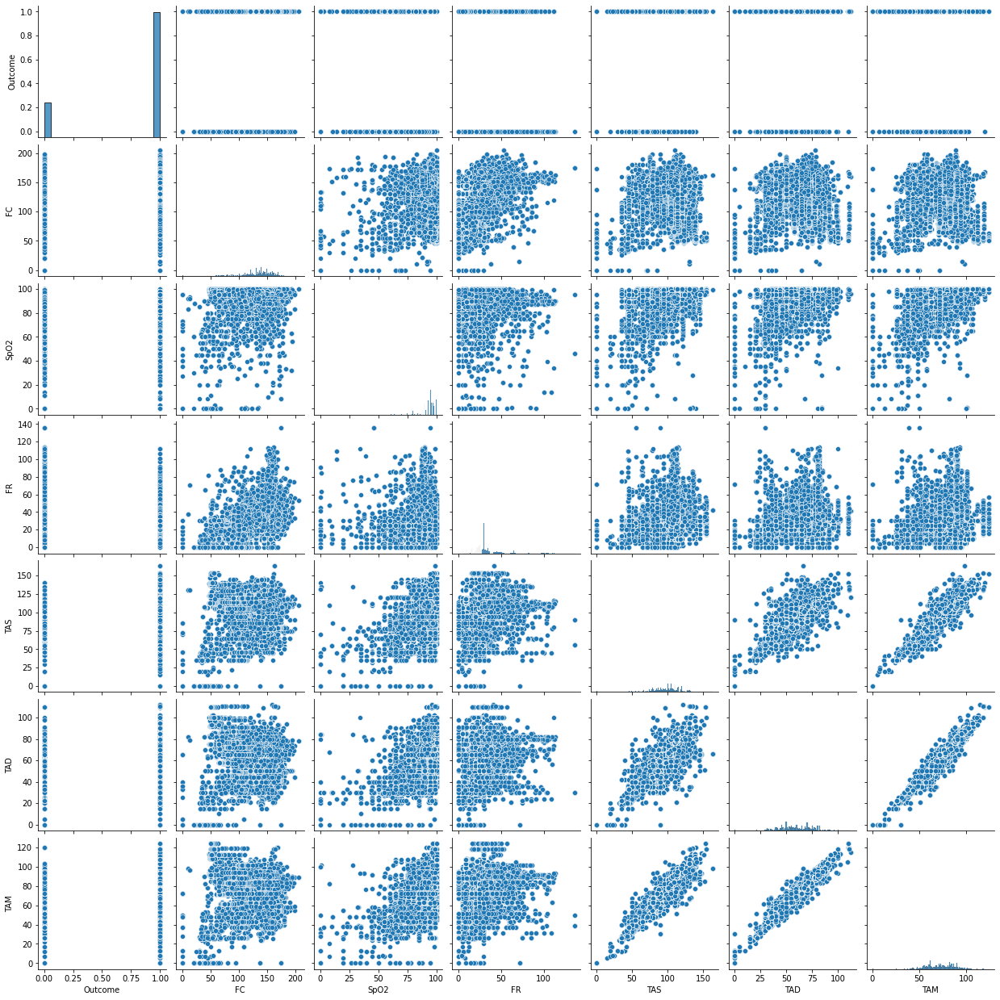

In [ ]:
sns.pairplot(shortUcip)

Matriz de correlación

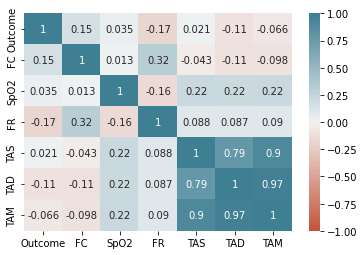

In [ ]:
corrMatrix = shortUcip.corr(method='spearman')
sns.heatmap(corrMatrix, annot=True, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(20, 220, n=200))
plt.show()

Debido a que la correlación entre TAS, TAD y TAM es muy alta, se eliminan del dataset TAS y TAD.

In [ ]:
shortUcip.drop('TAS', inplace=True, axis=1)
shortUcip.drop('TAD', inplace=True, axis=1)

/usr/local/lib/python3.8/dist-packages/pandas/core/frame.py:4906: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().drop(


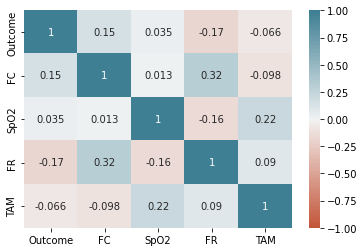

In [ ]:
corrMatrix = shortUcip.corr(method='spearman')
sns.heatmap(corrMatrix, annot=True, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(20, 220, n=200))
plt.show()

Diagrama de cajas

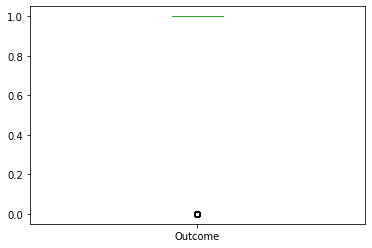

In [ ]:
shortUcip["Outcome"].plot.box()

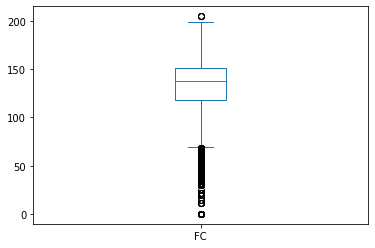

In [ ]:
shortUcip["FC"].plot.box()

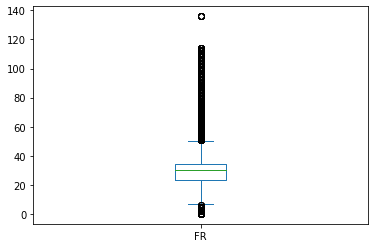

In [ ]:
shortUcip["FR"].plot.box()

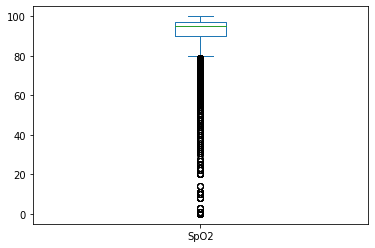

In [ ]:
shortUcip["SpO2"].plot.box()

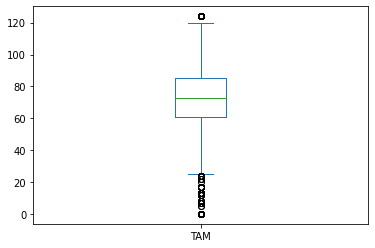

In [ ]:
shortUcip["TAM"].plot.box()

Distribuciones

In [ ]:
basicPatientInfo = ucip.iloc[:, [0, 1, 2, 3, 4]]
basicPatientInfo = basicPatientInfo.drop_duplicates()

basicPatientInfo.shape
basicPatientInfo

,Id,Age (months),Weight (Kg),Height (cms),Gender
0,1,2.0,5.5,60.0,0
1433,2,5.0,4.0,45.0,1
2915,3,7.0,7.0,64.0,1
3807,4,15.0,50.0,150.0,0
4205,5,4.0,5.0,52.0,1
...,...,...,...,...,...
89493,86,4.0,5.0,55.0,1
90980,87,84.0,30.0,120.0,0
91884,88,14.0,50.0,160.0,0
92288,89,3.0,13.0,97.0,0


In [ ]:
def ageToYears(value):
  val = value / 12
  if val < 1:
    return 0
  if val < 4:
    return 1
  if val < 6:
    return 2
  if val < 13:
    return 3
  return 4

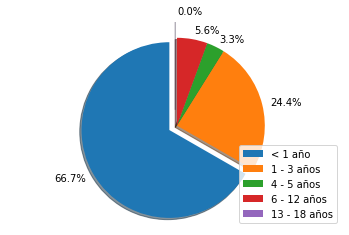

In [ ]:
basicPatientInfo['Age (range)'] = basicPatientInfo['Age (months)'].apply(lambda x : ageToYears(x))

group0 = round((basicPatientInfo[basicPatientInfo['Age (range)'] == 0]).shape[0] / 90 * 100, 1)
group1 = round((basicPatientInfo[basicPatientInfo['Age (range)'] == 1]).shape[0] / 90 * 100, 1)
group2 = round((basicPatientInfo[basicPatientInfo['Age (range)'] == 2]).shape[0] / 90 * 100, 1)
group3 = round((basicPatientInfo[basicPatientInfo['Age (range)'] == 3]).shape[0] / 90 * 100, 1)
group4 = round((basicPatientInfo[basicPatientInfo['Age (range)'] == 4]).shape[0] / 90 * 100, 1)

fig1, ax1 = plt.subplots()

groups = [group0, group1 , group2, group3, group4]
groups1 = [str(group0) + "%", str(group1) + "%", str(group2) + "%", str(group3) + "%", str(group4) + "%"]
labels = ['< 1 año', '1 - 3 años', '4 - 5 años', '6 - 12 años', '13 - 18 años']

explode = (0.1, 0, 0, 0, 0.2)
ax1.pie(groups, 
        explode=explode,
        labels=groups1,
        shadow=True, startangle=90)

ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
plt.legend(loc=4, labels=labels)

plt.show()


In [ ]:
ucip.head()

,Id,Age (months),Weight (Kg),Height (cms),Gender,Diagnosis,Outcome,Time,FC,SpO2,...,TAS,TAD,TAM,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2.0,5.5,60.0,0,myocarditis,1,18:52,138,92,...,100,56,73,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2.0,5.5,60.0,0,myocarditis,1,18:53,142,92,...,99,53,69,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2.0,5.5,60.0,0,myocarditis,1,18:54,139,92,...,99,52,68,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2.0,5.5,60.0,0,myocarditis,1,18:55,142,92,...,97,51,66,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2.0,5.5,60.0,0,myocarditis,1,18:56,144,92,...,102,56,71,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO


Análisis de Componentes Principales

In [ ]:
ucip

,Id,Age (months),Weight (Kg),Height (cms),Gender,Diagnosis,Outcome,Time,FC,SpO2,...,TAS,TAD,TAM,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2.0,5.5,60.0,0,myocarditis,1,18:52,138,92,...,100,56,73,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2.0,5.5,60.0,0,myocarditis,1,18:53,142,92,...,99,53,69,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2.0,5.5,60.0,0,myocarditis,1,18:54,139,92,...,99,52,68,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2.0,5.5,60.0,0,myocarditis,1,18:55,142,92,...,97,51,66,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2.0,5.5,60.0,0,myocarditis,1,18:56,144,92,...,102,56,71,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94673,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:40,105,78,...,46,33,37,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94674,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:41,105,78,...,46,33,37,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
94675,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:42,40,60,...,0,0,0,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94676,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:43,20,30,...,0,0,0,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO


# Aprendizaje automático - Clasificación de sobrevivencia según los signos vitales

**Árbol de clasificación**

In [ ]:
from sklearn import metrics
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import plot_confusion_matrix

from sklearn.metrics import roc_curve, roc_auc_score

from sklearn.tree import export_graphviz
from six import StringIO  
from IPython.display import Image  
import pydotplus

from sklearn.model_selection import cross_val_score
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

UCI = shortUcip
UCI.head()

,Outcome,FC,SpO2,FR,TAM
0,1,138,92,36,73
1,1,142,92,31,69
2,1,139,92,31,68
3,1,142,92,29,66
4,1,144,92,25,71


In [ ]:
feature_cols = UCI.loc[:, 'FC':'TAM'].columns
a = UCI[feature_cols]
b = UCI.Outcome
X_train, X_test, y_train, y_test = train_test_split(a, b, test_size=0.3, train_size=0.7, random_state=1)

In [ ]:
clf = DecisionTreeClassifier(max_depth=25)
clf = clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [ ]:
dot_data = StringIO()
export_graphviz(clf, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('ID.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.748122 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.748122 to fit



In [ ]:
clf_cv_score = cross_val_score(clf, a, b, cv=20, scoring='roc_auc')

print("=== Accuracy Score ===")
print("Accuracy Score - Tree Decision: ", accuracy_score(y_test, y_pred))

=== Accuracy Score ===
Accuracy Score - Tree Decision:  0.9938457185300463


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


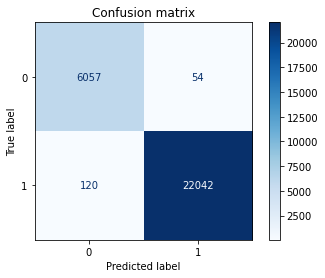

In [ ]:
plot_confusion_matrix(clf, X_test, y_test, cmap=plt.cm.Blues)
plt.title('Confusion matrix')
plt.show()

In [ ]:
#Feature Importance
DTC_FI = pd.DataFrame(list(zip(X_train, clf.feature_importances_)), columns = ["Items", "Importance"])
DTC_FI = DTC_FI.sort_values(by=["Importance"], ascending=False)
DTC_FI

,Items,Importance
0,FC,0.310522
2,FR,0.293646
3,TAM,0.258309
1,SpO2,0.137523


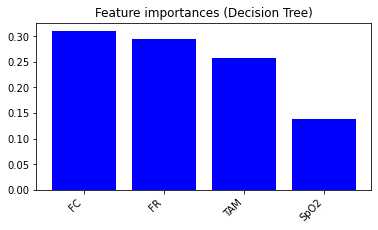

In [ ]:
n_features = 4
coefs = clf.feature_importances_
indices = np.argsort(coefs)[::-1]

plt.figure()
plt.title("Feature importances (Decision Tree)")
plt.bar(range(n_features), coefs[indices[:n_features]],
       color="b", align="center")
plt.xticks(range(n_features), DTC_FI.Items[indices[:n_features]], rotation=45, ha='right')
plt.subplots_adjust(bottom=0.3)

**Random Forest Classifier**

In [ ]:
#Import Random Forest Model
from sklearn.ensemble import RandomForestClassifier

#Create a Random Forest Classifier
rf_clf = RandomForestClassifier(n_estimators=20)

#Train the model using the training sets y_pred=clf.predict(X_test)
rf_clf.fit(X_train, y_train)

y_pred = rf_clf.predict(X_test)

In [ ]:
def drawTree(estimator_index):
  estimator = rf_clf.estimators_[estimator_index]
  export_graphviz(estimator, 
                  out_file='tree.dot', 
                  feature_names = feature_cols,
                  class_names = ['0','1'],
                  rounded = True, proportion = False, 
                  precision = 2, filled = True)

  # Convert to png using system command (requires Graphviz)
  from subprocess import call
  call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'])

In [ ]:
drawTree(0)

from IPython.display import Image
Image(filename = 'tree.png')

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score

print("=== Accuracy Score ===")
print("Accuracy Score - Random Forest: ", accuracy_score(y_test, y_pred))

=== Accuracy Score ===
Accuracy Score - Random Forest:  0.9923955717468963


/usr/local/lib/python3.8/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function plot_confusion_matrix is deprecated; Function `plot_confusion_matrix` is deprecated in 1.0 and will be removed in 1.2. Use one of the class methods: ConfusionMatrixDisplay.from_predictions or ConfusionMatrixDisplay.from_estimator.
  warnings.warn(msg, category=FutureWarning)


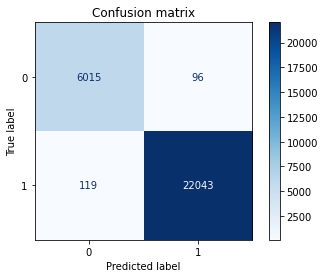

In [ ]:
plot_confusion_matrix(rf_clf, X_test, y_test, cmap=plt.cm.Blues)
plt.title('Confusion matrix')
plt.show()

# Aprendizaje automático - Clasificación de estado según signos vitales

In [ ]:
ucip

,Id,Age (months),Weight (Kg),Height (cms),Gender,Diagnosis,Outcome,Time,FC,SpO2,...,TAS,TAD,TAM,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2.0,5.5,60.0,0,myocarditis,1,18:52,138,92,...,100,56,73,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
1,1,2.0,5.5,60.0,0,myocarditis,1,18:53,142,92,...,99,53,69,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
2,1,2.0,5.5,60.0,0,myocarditis,1,18:54,139,92,...,99,52,68,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
3,1,2.0,5.5,60.0,0,myocarditis,1,18:55,142,92,...,97,51,66,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
4,1,2.0,5.5,60.0,0,myocarditis,1,18:56,144,92,...,102,56,71,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94673,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:40,105,78,...,46,33,37,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94674,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:41,105,78,...,46,33,37,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO
94675,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:42,40,60,...,0,0,0,1,NORMAL,NORMAL,BAJO,NORMAL,NORMAL,ALTO
94676,90,6.0,8.0,67.0,1,bronchiolitis-prematurity-heart disease,0,7:43,20,30,...,0,0,0,1,NORMAL,NORMAL,NORMAL,NORMAL,NORMAL,ALTO


In [ ]:
pd.options.mode.chained_assignment = None

In [ ]:
short_categorical = ucip.iloc[:, [0, 1, 9, 8, 10, 13, 14]]
short_categorical.head()

short_categorical.drop(short_categorical[short_categorical['Id'] == 12].index, inplace = True)
short_categorical.drop(short_categorical[short_categorical['Id'] == 24].index, inplace = True)
short_categorical.drop(short_categorical[short_categorical['Id'] == 53].index, inplace = True)
short_categorical.drop(short_categorical[short_categorical['Id'] == 67].index, inplace = True)
short_categorical.drop(short_categorical[short_categorical['Id'] == 79].index, inplace = True)

short_categorical = short_categorical.iloc[:, [0, 1, 2, 3, 4, 5, 6]]

short_categorical.head()

,Id,Age (months),SpO2,FC,FR,TAM,Condition
0,1,2.0,92,138,36,73,1
1,1,2.0,92,142,31,69,1
2,1,2.0,92,139,31,68,1
3,1,2.0,92,142,29,66,1
4,1,2.0,92,144,25,71,1


In [ ]:
ucip_group_1 = short_categorical[short_categorical["Age (months)"] < 12]
ucip_group_1

,Id,Age (months),SpO2,FC,FR,TAM,Condition
0,1,2.0,92,138,36,73,1
1,1,2.0,92,142,31,69,1
2,1,2.0,92,139,31,68,1
3,1,2.0,92,142,29,66,1
4,1,2.0,92,144,25,71,1
...,...,...,...,...,...,...,...
94673,90,6.0,78,105,0,37,1
94674,90,6.0,78,105,0,37,1
94675,90,6.0,60,40,0,0,1
94676,90,6.0,30,20,0,0,1


In [ ]:
ucip_group_2 = short_categorical[short_categorical["Age (months)"] >= 12]
ucip_group_2 = ucip_group_2[ucip_group_2["Age (months)"] < 48]
ucip_group_2

,Id,Age (months),SpO2,FC,FR,TAM,Condition
3807,4,15.0,93,156,47,78,1
3808,4,15.0,93,155,47,79,1
3809,4,15.0,94,152,45,80,1
3810,4,15.0,94,152,46,82,1
3811,4,15.0,92,152,44,80,1
...,...,...,...,...,...,...,...
92283,88,14.0,60,35,8,28,1
92284,88,14.0,60,40,8,28,1
92285,88,14.0,65,45,5,28,1
92286,88,14.0,93,140,30,78,1


In [ ]:
ucip_group_3 = short_categorical[short_categorical["Age (months)"] >= 48]
ucip_group_3 = ucip_group_3[ucip_group_3["Age (months)"] < 72]
ucip_group_3

,Id,Age (months),SpO2,FC,FR,TAM,Condition
7885,8,60.0,96,74,26,71,1
7886,8,60.0,96,73,26,71,1
7887,8,60.0,96,72,26,71,1
7888,8,60.0,96,73,26,71,1
7889,8,60.0,96,72,26,71,1
...,...,...,...,...,...,...,...
78875,75,60.0,34,68,18,0,1
78876,75,60.0,34,68,18,0,1
78877,75,60.0,34,68,18,0,1
78878,75,60.0,0,0,0,0,1


In [ ]:
ucip_group_4 = short_categorical[short_categorical["Age (months)"] >= 72]
ucip_group_4 = ucip_group_4[ucip_group_4["Age (months)"] < 144]
ucip_group_4

,Id,Age (months),SpO2,FC,FR,TAM,Condition
20138,20,72.0,96,74,26,71,1
20139,20,72.0,96,73,26,71,1
20140,20,72.0,96,72,26,71,1
20141,20,72.0,96,73,26,71,1
20142,20,72.0,96,72,26,71,1
...,...,...,...,...,...,...,...
91879,87,84.0,95,110,20,73,1
91880,87,84.0,95,110,20,73,1
91881,87,84.0,95,110,20,73,1
91882,87,84.0,95,110,20,73,1


In [ ]:
p0 = ucip_group_1[ucip_group_1["Condition"] == 0]
p1 = ucip_group_1[ucip_group_1["Condition"] == 1]
p2 = ucip_group_1[ucip_group_1["Condition"] == 2]
print(len(p0), len(p1), len(p2))

p0 = ucip_group_2[ucip_group_2["Condition"] == 0]
p1 = ucip_group_2[ucip_group_2["Condition"] == 1]
p2 = ucip_group_2[ucip_group_2["Condition"] == 2]
print(len(p0), len(p1), len(p2))

p0 = ucip_group_3[ucip_group_3["Condition"] == 0]
p1 = ucip_group_3[ucip_group_3["Condition"] == 1]
p2 = ucip_group_3[ucip_group_3["Condition"] == 2]
print(len(p0), len(p1), len(p2))

p0 = ucip_group_4[ucip_group_4["Condition"] == 0]
p1 = ucip_group_4[ucip_group_4["Condition"] == 1]
p2 = ucip_group_4[ucip_group_4["Condition"] == 2]
print(len(p0), len(p1), len(p2))

1076 63876 7844
80 9036 1286
19 2595 9
57 4075 181


In [ ]:
import pickle
from sklearn.metrics import confusion_matrix, f1_score, recall_score, precision_score

In [ ]:
#definimos funciona para mostrar los resultados
def show_results(y_test, pred_y):
  conf_matrix = confusion_matrix(y_test, pred_y)
  plt.figure(figsize=(5, 5))
  sns.heatmap(conf_matrix, annot=True, fmt="d");
  plt.title("Confusion matrix")
  plt.ylabel('True class')
  plt.xlabel('Predicted class')
  plt.show()
  print(classification_report(y_test, pred_y))

**Estrategias de balanceo**

Con el objetivo de balancear las clases en el conjunto de datos se deben modificar los pesos antes de ingresar al modelo. Por lo tanto, se calcularán la cantidad de datos por cada clase en cada grupo y se calcularán los pesos. Por otro lado, se escribirá una función para crear los conjuntos de entrenamiento y test.

In [ ]:
def getTestSplit(current_df):
  feature_cols = current_df.loc[:, 'SpO2':'TAM'].columns
  x = current_df[feature_cols]
  y = current_df.Condition
  return train_test_split(x, y, test_size=0.3, train_size=0.7, random_state=17, stratify=y)

In [ ]:
def getDiffrence(df_class_1, df_class_2):
  if len(df_class_1) > len(df_class_2):
    return len(df_class_1) / len(df_class_2)
  return len(df_class_2) / len(df_class_1)

In [ ]:
# Test and train subsets - Group 1
ucip_group_1_c = pd.DataFrame(ucip_group_1)
ucip_group_1_c.drop(ucip_group_1_c[ucip_group_1_c['Condition'] == 2].index, inplace = True)
ucip_group_1_c = ucip_group_1_c.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_1_c, X_test_1_c, y_train_1_c, y_test_1_c = getTestSplit(ucip_group_1_c)

ucip_group_1_s = pd.DataFrame(ucip_group_1)
ucip_group_1_s.drop(ucip_group_1_s[ucip_group_1_s['Condition'] == 0].index, inplace = True)
ucip_group_1_s = ucip_group_1_s.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_1_s, X_test_1_s, y_train_1_s, y_test_1_s = getTestSplit(ucip_group_1_s)

p0 = ucip_group_1_c[ucip_group_1_c["Condition"] == 0]
p1 = ucip_group_1_c[ucip_group_1_c["Condition"] == 1]
p1Aux = ucip_group_1_s[ucip_group_1_s["Condition"] == 1]
p2 = ucip_group_1_s[ucip_group_1_s["Condition"] == 2]
print("0:", len(p0), "-", "1:", len(p1), "-", "2:", len(p2))
d_1_c = getDiffrence(p0, p1)
d_1_s = getDiffrence(p1, p2)
#print(d_1_c, d_1_s)

0: 1076 - 1: 63876 - 2: 7844


In [ ]:
# Test and train subsets - Group 2
ucip_group_2_c = pd.DataFrame(ucip_group_2)
ucip_group_2_c.drop(ucip_group_2_c[ucip_group_2_c['Condition'] == 2].index, inplace = True)
ucip_group_2_c = ucip_group_2_c.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_2_c, X_test_2_c, y_train_2_c, y_test_2_c = getTestSplit(ucip_group_2_c)

ucip_group_2_s = pd.DataFrame(ucip_group_2)
ucip_group_2_s.drop(ucip_group_2_s[ucip_group_2_s['Condition'] == 0].index, inplace = True)
ucip_group_2_s = ucip_group_2_s.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_2_s, X_test_2_s, y_train_2_s, y_test_2_s = getTestSplit(ucip_group_2_s)

p0 = ucip_group_2_c[ucip_group_2_c["Condition"] == 0]
p1 = ucip_group_2_c[ucip_group_2_c["Condition"] == 1]
p1Aux = ucip_group_2_s[ucip_group_2_s["Condition"] == 1]
p2 = ucip_group_2_s[ucip_group_2_s["Condition"] == 2]
print("0:", len(p0), "-", "1:", len(p1), "-", "2:", len(p2))
d_2_c = getDiffrence(p0, p1)
d_2_s = getDiffrence(p1, p2)
#print(d_2_c, d_2_s)

0: 80 - 1: 9036 - 2: 1286


In [ ]:
# Test and train subsets - Group 3
ucip_group_3_c = pd.DataFrame(ucip_group_3)
ucip_group_3_c.drop(ucip_group_3_c[ucip_group_3_c['Condition'] == 2].index, inplace = True)
ucip_group_3_c = ucip_group_3_c.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_3_c, X_test_3_c, y_train_3_c, y_test_3_c = getTestSplit(ucip_group_3_c)

ucip_group_3_s = pd.DataFrame(ucip_group_3)
ucip_group_3_s.drop(ucip_group_3_s[ucip_group_3_s['Condition'] == 0].index, inplace = True)
ucip_group_3_s = ucip_group_3_s.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_3_s, X_test_3_s, y_train_3_s, y_test_3_s = getTestSplit(ucip_group_3_s)

p0 = ucip_group_3_c[ucip_group_3_c["Condition"] == 0]
p1 = ucip_group_3_c[ucip_group_3_c["Condition"] == 1]
p1Aux = ucip_group_3_s[ucip_group_3_s["Condition"] == 1]
p2 = ucip_group_3_s[ucip_group_3_s["Condition"] == 2]
print("0:", len(p0), "-", "1:", len(p1), "-", "2:", len(p2))
d_3_c = getDiffrence(p0, p1)
d_3_s = getDiffrence(p1, p2)
#print(d_3_c, d_3_s)

0: 19 - 1: 2595 - 2: 9


In [ ]:
# Test and train subsets - Group 4
ucip_group_4_c = pd.DataFrame(ucip_group_4)
ucip_group_4_c.drop(ucip_group_4_c[ucip_group_4_c['Condition'] == 2].index, inplace = True)
ucip_group_4_c = ucip_group_4_c.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_4_c, X_test_4_c, y_train_4_c, y_test_4_c = getTestSplit(ucip_group_4_c)

ucip_group_4_s = pd.DataFrame(ucip_group_4)
ucip_group_4_s.drop(ucip_group_4_s[ucip_group_4_s['Condition'] == 0].index, inplace = True)
ucip_group_4_s = ucip_group_4_s.iloc[:, [0, 2, 3, 4, 5, 6]]
X_train_4_s, X_test_4_s, y_train_4_s, y_test_4_s = getTestSplit(ucip_group_4_s)

p0 = ucip_group_4_c[ucip_group_4_c["Condition"] == 0]
p1 = ucip_group_4_c[ucip_group_4_c["Condition"] == 1]
p1Aux = ucip_group_4_s[ucip_group_4_s["Condition"] == 1]
p2 = ucip_group_4_s[ucip_group_4_s["Condition"] == 2]
print("0:", len(p0), "-", "1:", len(p1), "-", "2:", len(p2))
d_4_c = getDiffrence(p0, p1)
d_4_s = getDiffrence(p1, p2)
#print(d_4_c, d_4_s)

0: 57 - 1: 4075 - 2: 181


**Simple Algorithm**

In [ ]:
def normalFc1(value):
  result = value >= 100 and value <= 160
  return 1 if result else 0

def normalFr1(value):
  result = value >= 30 and value <= 60
  return 1 if result else 0

def normalTas1(value):
  result = value >= 60 and value <= 90
  return 1 if result else 0

def normalTad1(value):
  result = value >= 30 and value <= 62
  return 1 if result else 0

def normalSpO21(value):
  result = value > 88
  return 1 if result else 0

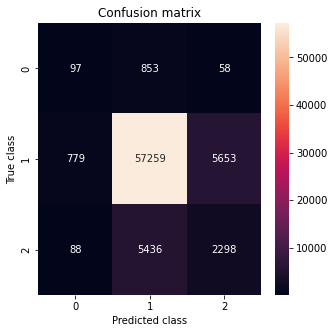

              precision    recall  f1-score   support

         0.0       0.10      0.10      0.10      1008
         1.0       0.90      0.90      0.90     63691
         2.0       0.29      0.29      0.29      7822

    accuracy                           0.82     72521
   macro avg       0.43      0.43      0.43     72521
weighted avg       0.82      0.82      0.82     72521



In [ ]:
y_cal_group_1 = []
y_group_1 = []

good = 0
bad = 0

ucip_a = ucip.iloc[:, [0, 1, 9, 8, 10, 11, 12, 14]]
asd = ucip_a[ucip_a["Age (months)"] < 12]

#ucip_group_1

for index, row in asd.iterrows():
  normalFc = normalFc1(row["FC"])
  normalFr = normalFr1(row["FR"])
  normalTas = normalTas1(row["TAS"])
  normalTad = normalTad1(row["TAD"])
  normalSpO2 = normalSpO21(row["SpO2"])

  if row["SpO2"] == 0:
    continue


  c = normalFc + normalFr + normalTas + normalTad + normalSpO2
  
  result = 1
  if c == 0:
    result = 0
  elif c == 5:
    result = 2

  # Cambio de estado no permitido
  #if len(y_cal_group_1) > 1:
  #  if (result == 0 and y_cal_group_1[-1] == 2) or (result == 2 and y_cal_group_1[-1] == 0):
  #    result = y_cal_group_1[-1]


  if result == row["Condition"]:
    good = good + 1
  else:
    bad = bad + 1

  y_cal_group_1.append(result)
  y_group_1.append(row["Condition"])

show_results(y_group_1, y_cal_group_1)

In [ ]:
ucip_a = ucip.iloc[:, [0, 1, 9, 8, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20]]
ucip_a = ucip_a[ucip_a["Age (months)"] < 12]

In [ ]:
def fixCategory(value):
  if value == "MUY ALTO":
    return 1
  if value == "ALTO":
    return 1
  if value == "NORMAL":
    return 0
  if value == "BAJO":
    return 1
  if value == "MUY BAJO":
    return 1
  
ucip_a['FCT'] = ucip_a['FCT'].apply(lambda x : fixCategory(x))
ucip_a['SP02T'] = ucip_a['SP02T'].apply(lambda x : fixCategory(x))
ucip_a['FRT'] = ucip_a['FRT'].apply(lambda x : fixCategory(x))
ucip_a['TAST'] = ucip_a['TAST'].apply(lambda x : fixCategory(x))
ucip_a['TADT'] = ucip_a['TADT'].apply(lambda x : fixCategory(x))
ucip_a['TAMT'] = ucip_a['TAMT'].apply(lambda x : fixCategory(x))

In [ ]:
ucip_a

,Id,Age (months),SpO2,FC,FR,TAS,TAD,Condition,FCT,SP02T,FRT,TAST,TADT,TAMT
0,1,2.0,92,138,36,100,56,1,0,0,0.0,0,0,1
1,1,2.0,92,142,31,99,53,1,0,0,0.0,0,0,1
2,1,2.0,92,139,31,99,52,1,0,0,0.0,0,0,1
3,1,2.0,92,142,29,97,51,1,0,0,1.0,0,0,1
4,1,2.0,92,144,25,102,56,1,0,0,1.0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94673,90,6.0,78,105,0,46,33,1,0,0,1.0,0,0,1
94674,90,6.0,78,105,0,46,33,1,0,0,0.0,0,0,1
94675,90,6.0,60,40,0,0,0,1,0,0,1.0,0,0,1
94676,90,6.0,30,20,0,0,0,1,0,0,0.0,0,0,1


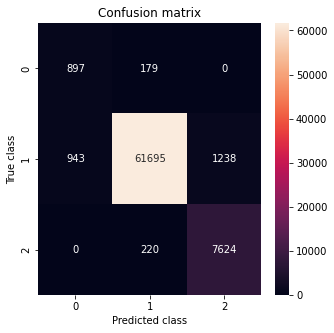

              precision    recall  f1-score   support

         0.0       0.49      0.83      0.62      1076
         1.0       0.99      0.97      0.98     63876
         2.0       0.86      0.97      0.91      7844

    accuracy                           0.96     72796
   macro avg       0.78      0.92      0.84     72796
weighted avg       0.97      0.96      0.97     72796



In [ ]:
y_cal_group_1 = []
y_group_1 = []

good = 0
bad = 0

for index, row in ucip_a.iterrows():
  normalFc = row["FCT"]
  normalFr = row["FRT"]
  normalTas = row["TAST"]
  normalTad = row["TADT"]
  normalTad = row["TAMT"]
  normalTam = row["TAMT"]
  normalSpO2 = row["SP02T"]


  c = normalFc + normalFr + normalTas + normalTad + normalTam + normalSpO2
  
  result = 1
  if c == 0:
    result = 2
  elif c > 5:
    result = 0

  if result == row["Condition"]:
    good = good + 1
  else:
    bad = bad + 1

  y_cal_group_1.append(result)
  y_group_1.append(row["Condition"])

show_results(y_group_1, y_cal_group_1)

**Tree Decision Classifier**

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import seaborn as sns

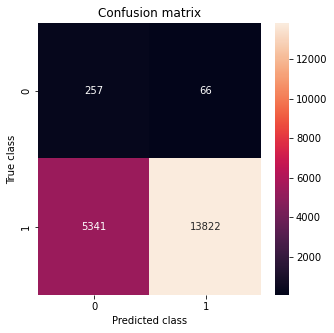

              precision    recall  f1-score   support

           0       0.05      0.80      0.09       323
           1       1.00      0.72      0.84     19163

    accuracy                           0.72     19486
   macro avg       0.52      0.76      0.46     19486
weighted avg       0.98      0.72      0.82     19486



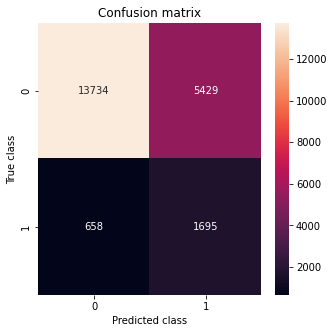

              precision    recall  f1-score   support

           1       0.95      0.72      0.82     19163
           2       0.24      0.72      0.36      2353

    accuracy                           0.72     21516
   macro avg       0.60      0.72      0.59     21516
weighted avg       0.88      0.72      0.77     21516



In [ ]:
# Create Decision Tree classifer object
dtc_balanced_1_c = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={0: d_1_c, 1: 1})
dtc_balanced_1_s = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={2: d_1_s, 1: 1})

# Train Decision Tree Classifer
decision_tree_model_1_c = dtc_balanced_1_c.fit(X_train_1_c, y_train_1_c)
pickle.dump(decision_tree_model_1_c, open("decision_tree_model_1_c.sav", 'wb'))
decision_tree_model_1_s = dtc_balanced_1_s.fit(X_train_1_s, y_train_1_s)
pickle.dump(decision_tree_model_1_s, open("decision_tree_model_1_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_1_c = decision_tree_model_1_c.predict(X_test_1_c)
y_pred_1_s = decision_tree_model_1_s.predict(X_test_1_s)

show_results(y_test_1_c, y_pred_1_c)
show_results(y_test_1_s, y_pred_1_s)

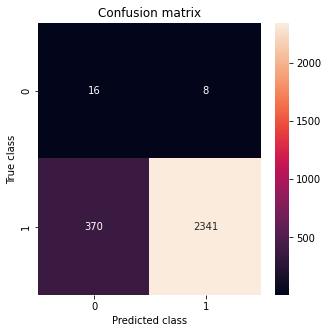

              precision    recall  f1-score   support

           0       0.04      0.67      0.08        24
           1       1.00      0.86      0.93      2711

    accuracy                           0.86      2735
   macro avg       0.52      0.77      0.50      2735
weighted avg       0.99      0.86      0.92      2735



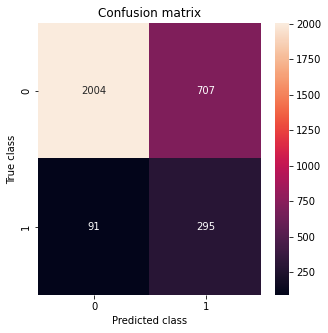

              precision    recall  f1-score   support

           1       0.96      0.74      0.83      2711
           2       0.29      0.76      0.43       386

    accuracy                           0.74      3097
   macro avg       0.63      0.75      0.63      3097
weighted avg       0.87      0.74      0.78      3097



In [ ]:
# Create Decision Tree classifer object
dtc_balanced_2_c = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={0: d_2_c, 1: 1})
dtc_balanced_2_s = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={2: d_2_s, 1: 1})

# Train Decision Tree Classifer
decision_tree_model_2_c = dtc_balanced_2_c.fit(X_train_2_c, y_train_2_c)
pickle.dump(decision_tree_model_2_c, open("decision_tree_model_2_c.sav", 'wb'))
decision_tree_model_2_s = dtc_balanced_2_s.fit(X_train_2_s, y_train_2_s)
pickle.dump(decision_tree_model_2_s, open("decision_tree_model_2_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_2_c = decision_tree_model_2_c.predict(X_test_2_c)
y_pred_2_s = decision_tree_model_2_s.predict(X_test_2_s)

show_results(y_test_2_c, y_pred_2_c)
show_results(y_test_2_s, y_pred_2_s)

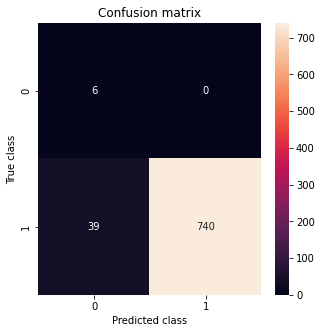

              precision    recall  f1-score   support

           0       0.13      1.00      0.24         6
           1       1.00      0.95      0.97       779

    accuracy                           0.95       785
   macro avg       0.57      0.97      0.60       785
weighted avg       0.99      0.95      0.97       785



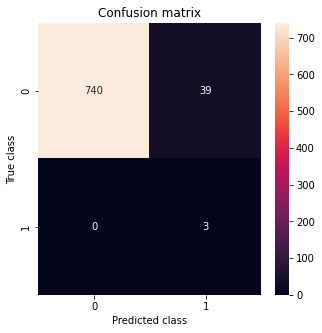

              precision    recall  f1-score   support

           1       1.00      0.95      0.97       779
           2       0.07      1.00      0.13         3

    accuracy                           0.95       782
   macro avg       0.54      0.97      0.55       782
weighted avg       1.00      0.95      0.97       782



In [ ]:
# Create Decision Tree classifer object
dtc_balanced_3_c = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={0: d_3_c, 1: 1})
dtc_balanced_3_s = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={2: d_3_s, 1: 1})

# Train Decision Tree Classifer
decision_tree_model_3_c = dtc_balanced_3_c.fit(X_train_3_c, y_train_3_c)
pickle.dump(decision_tree_model_3_c, open("decision_tree_model_3_c.sav", 'wb'))
decision_tree_model_3_s = dtc_balanced_3_s.fit(X_train_3_s, y_train_3_s)
pickle.dump(decision_tree_model_3_s, open("decision_tree_model_3_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_3_c = decision_tree_model_3_c.predict(X_test_3_c)
y_pred_3_s = decision_tree_model_3_s.predict(X_test_3_s)

show_results(y_test_3_c, y_pred_3_c)
show_results(y_test_3_s, y_pred_3_s)

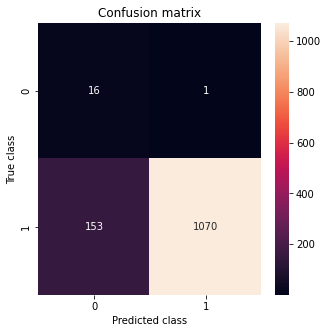

              precision    recall  f1-score   support

           0       0.09      0.94      0.17        17
           1       1.00      0.87      0.93      1223

    accuracy                           0.88      1240
   macro avg       0.55      0.91      0.55      1240
weighted avg       0.99      0.88      0.92      1240



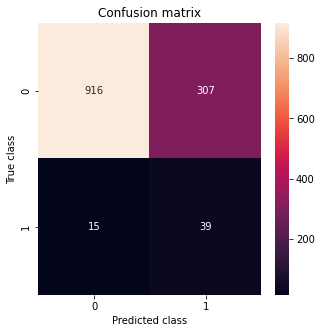

              precision    recall  f1-score   support

           1       0.98      0.75      0.85      1223
           2       0.11      0.72      0.19        54

    accuracy                           0.75      1277
   macro avg       0.55      0.74      0.52      1277
weighted avg       0.95      0.75      0.82      1277



In [ ]:
# Create Decision Tree classifer object
dtc_balanced_4_c = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={0: d_4_c, 1: 1})
dtc_balanced_4_s = DecisionTreeClassifier(max_depth=100, min_samples_split=256, class_weight={2: d_4_s, 1: 1})

# Train Decision Tree Classifer
decision_tree_model_4_c = dtc_balanced_4_c.fit(X_train_4_c, y_train_4_c)
pickle.dump(decision_tree_model_4_c, open("decision_tree_model_4_c.sav", 'wb'))
decision_tree_model_4_s = dtc_balanced_4_s.fit(X_train_4_s, y_train_4_s)
pickle.dump(decision_tree_model_4_s, open("decision_tree_model_4_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_4_c = decision_tree_model_4_c.predict(X_test_4_c)
y_pred_4_s = decision_tree_model_4_s.predict(X_test_4_s)

show_results(y_test_4_c, y_pred_4_c)
show_results(y_test_4_s, y_pred_4_s)

**Random Forest Classifier**

In [ ]:
print(d_1_c)
print(d_1_s)
print(d_2_c)
print(d_2_s)
print(d_3_c)
print(d_3_s)
print(d_4_c)
print(d_4_s)

59.36431226765799
8.14329423763386
112.95
7.026438569206843
136.57894736842104
288.3333333333333
71.49122807017544
22.513812154696133


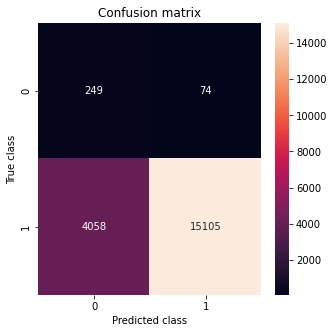

              precision    recall  f1-score   support

           0       0.06      0.77      0.11       323
           1       1.00      0.79      0.88     19163

    accuracy                           0.79     19486
   macro avg       0.53      0.78      0.49     19486
weighted avg       0.98      0.79      0.87     19486



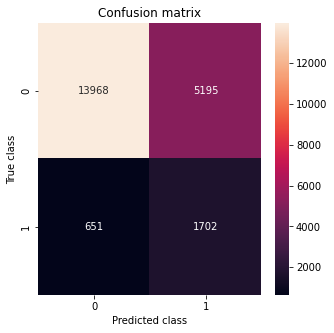

              precision    recall  f1-score   support

           1       0.96      0.73      0.83     19163
           2       0.25      0.72      0.37      2353

    accuracy                           0.73     21516
   macro avg       0.60      0.73      0.60     21516
weighted avg       0.88      0.73      0.78     21516



In [ ]:
rfc_balanced_1_c = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={0: 1.2*d_1_c, 1: 1})
rfc_balanced_1_s = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={2: 1.2*d_1_s, 1: 1})

# Train Random Forest Classifer
rfc_model_1_c = rfc_balanced_1_c.fit(X_train_1_c, y_train_1_c)
pickle.dump(rfc_model_1_c, open("rfc_model_1_c.sav", 'wb'))
rfc_model_1_s = rfc_balanced_1_s.fit(X_train_1_s, y_train_1_s)
pickle.dump(rfc_model_1_s, open("rfc_model_1_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_1_c = rfc_model_1_c.predict(X_test_1_c)
y_pred_1_s = rfc_model_1_s.predict(X_test_1_s)

show_results(y_test_1_c, y_pred_1_c)
show_results(y_test_1_s, y_pred_1_s)

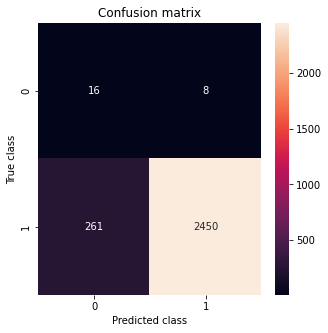

              precision    recall  f1-score   support

           0       0.06      0.67      0.11        24
           1       1.00      0.90      0.95      2711

    accuracy                           0.90      2735
   macro avg       0.53      0.79      0.53      2735
weighted avg       0.99      0.90      0.94      2735



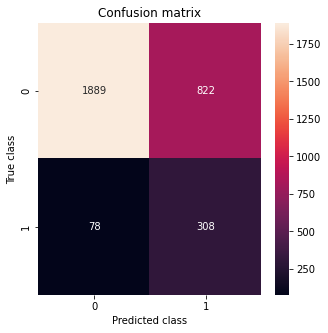

              precision    recall  f1-score   support

           1       0.96      0.70      0.81      2711
           2       0.27      0.80      0.41       386

    accuracy                           0.71      3097
   macro avg       0.62      0.75      0.61      3097
weighted avg       0.87      0.71      0.76      3097



In [ ]:
rfc_balanced_2_c = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={0: 1.2*d_2_c, 1: 1})
rfc_balanced_2_s = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={2: 1.2*d_2_s, 1: 1})

# Train Random Forest Classifer
rfc_model_2_c = rfc_balanced_2_c.fit(X_train_2_c, y_train_2_c)
pickle.dump(rfc_model_2_c, open("rfc_model_2_c.sav", 'wb'))
rfc_model_2_s = rfc_balanced_2_s.fit(X_train_2_s, y_train_2_s)
pickle.dump(rfc_model_2_s, open("rfc_model_2_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_2_c = rfc_model_2_c.predict(X_test_2_c)
y_pred_2_s = rfc_model_2_s.predict(X_test_2_s)

show_results(y_test_2_c, y_pred_2_c)
show_results(y_test_2_s, y_pred_2_s)

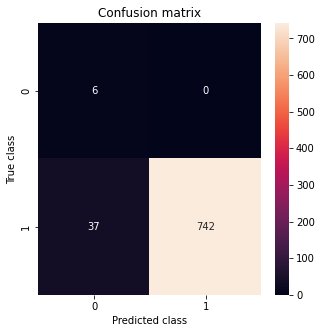

              precision    recall  f1-score   support

           0       0.14      1.00      0.24         6
           1       1.00      0.95      0.98       779

    accuracy                           0.95       785
   macro avg       0.57      0.98      0.61       785
weighted avg       0.99      0.95      0.97       785



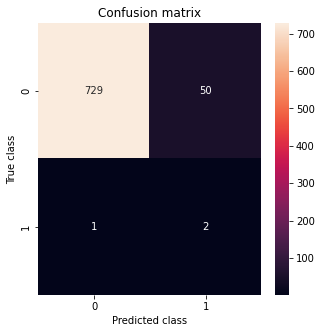

              precision    recall  f1-score   support

           1       1.00      0.94      0.97       779
           2       0.04      0.67      0.07         3

    accuracy                           0.93       782
   macro avg       0.52      0.80      0.52       782
weighted avg       0.99      0.93      0.96       782



In [ ]:
rfc_balanced_3_c = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={0: 1.2*d_3_c, 1: 1})
rfc_balanced_3_s = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={2: 1.2*d_3_s, 1: 1})

# Train Random Forest Classifer
rfc_model_3_c = rfc_balanced_3_c.fit(X_train_3_c, y_train_3_c)
pickle.dump(rfc_model_3_c, open("rfc_model_3_c.sav", 'wb'))
rfc_model_3_s = rfc_balanced_3_s.fit(X_train_3_s, y_train_3_s)
pickle.dump(rfc_model_3_s, open("rfc_model_3_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_3_c = rfc_model_3_c.predict(X_test_3_c)
y_pred_3_s = rfc_model_3_s.predict(X_test_3_s)

show_results(y_test_3_c, y_pred_3_c)
show_results(y_test_3_s, y_pred_3_s)

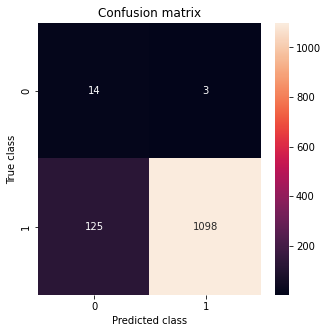

              precision    recall  f1-score   support

           0       0.10      0.82      0.18        17
           1       1.00      0.90      0.94      1223

    accuracy                           0.90      1240
   macro avg       0.55      0.86      0.56      1240
weighted avg       0.98      0.90      0.93      1240



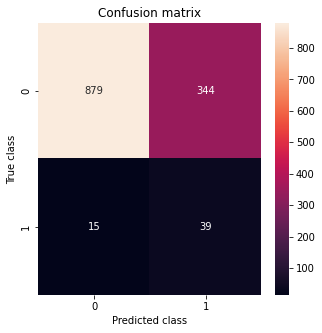

              precision    recall  f1-score   support

           1       0.98      0.72      0.83      1223
           2       0.10      0.72      0.18        54

    accuracy                           0.72      1277
   macro avg       0.54      0.72      0.50      1277
weighted avg       0.95      0.72      0.80      1277



In [ ]:
rfc_balanced_4_c = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={0: 1.2*d_4_c, 1: 1})
rfc_balanced_4_s = RandomForestClassifier(n_estimators=100, min_samples_split=256, class_weight={2: 1.2*d_4_s, 1: 1})

# Train Random Forest Classifer
rfc_model_4_c = rfc_balanced_4_c.fit(X_train_4_c, y_train_4_c)
pickle.dump(rfc_model_4_c, open("rfc_model_4_c.sav", 'wb'))
rfc_model_4_s = rfc_balanced_4_s.fit(X_train_4_s, y_train_4_s)
pickle.dump(rfc_model_4_s, open("rfc_model_4_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_4_c = rfc_model_4_c.predict(X_test_4_c)
y_pred_4_s = rfc_model_4_s.predict(X_test_4_s)

show_results(y_test_4_c, y_pred_4_c)
show_results(y_test_4_s, y_pred_4_s)

**Logistic Regression Classifier**

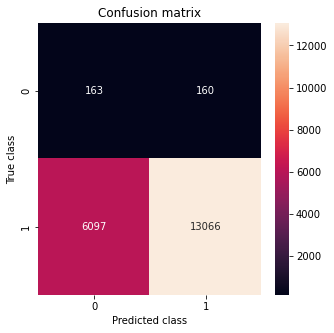

              precision    recall  f1-score   support

           0       0.03      0.50      0.05       323
           1       0.99      0.68      0.81     19163

    accuracy                           0.68     19486
   macro avg       0.51      0.59      0.43     19486
weighted avg       0.97      0.68      0.79     19486



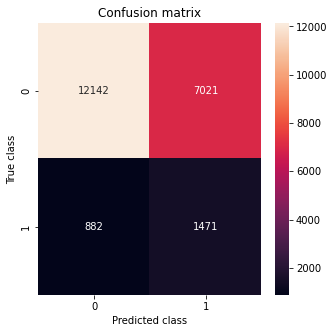

              precision    recall  f1-score   support

           1       0.93      0.63      0.75     19163
           2       0.17      0.63      0.27      2353

    accuracy                           0.63     21516
   macro avg       0.55      0.63      0.51     21516
weighted avg       0.85      0.63      0.70     21516



In [ ]:
lrc_balanced_1_c = LogisticRegression(solver='lbfgs', max_iter=50, class_weight={0: d_1_c, 1: 1})
lrc_balanced_1_s = LogisticRegression(solver='lbfgs', max_iter=100, class_weight={2: d_1_s, 1: 1})

# Train Logistic Regression Classifer
lrc_model_1_c = lrc_balanced_1_c.fit(X_train_1_c, y_train_1_c)
pickle.dump(lrc_model_1_c, open("lrc_model_1_c.sav", 'wb'))
lrc_model_1_s = lrc_balanced_1_s.fit(X_train_1_s, y_train_1_s)
pickle.dump(lrc_model_1_s, open("lrc_model_1_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_1_c = lrc_model_1_c.predict(X_test_1_c)
y_pred_1_s = lrc_model_1_s.predict(X_test_1_s)

show_results(y_test_1_c, y_pred_1_c)
show_results(y_test_1_s, y_pred_1_s)

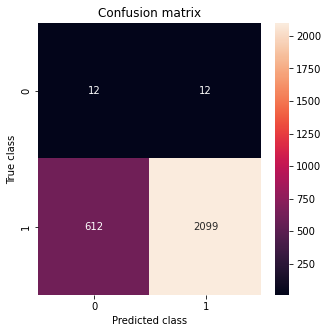

              precision    recall  f1-score   support

           0       0.02      0.50      0.04        24
           1       0.99      0.77      0.87      2711

    accuracy                           0.77      2735
   macro avg       0.51      0.64      0.45      2735
weighted avg       0.99      0.77      0.86      2735



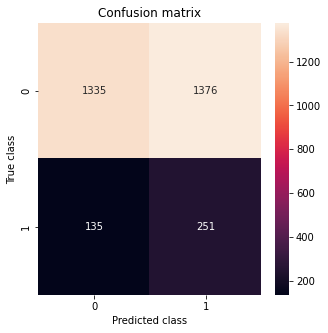

              precision    recall  f1-score   support

           1       0.91      0.49      0.64      2711
           2       0.15      0.65      0.25       386

    accuracy                           0.51      3097
   macro avg       0.53      0.57      0.44      3097
weighted avg       0.81      0.51      0.59      3097



In [ ]:
lrc_balanced_2_c = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={0: d_2_c, 1: 1})
lrc_balanced_2_s = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={2: d_2_s, 1: 1})

# Train Logistic Regression Classifer
lrc_model_2_c = lrc_balanced_2_c.fit(X_train_2_c, y_train_2_c)
pickle.dump(lrc_model_2_c, open("lrc_model_2_c.sav", 'wb'))
lrc_model_2_s = lrc_balanced_2_s.fit(X_train_2_s, y_train_2_s)
pickle.dump(lrc_model_2_s, open("lrc_model_2_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_2_c = lrc_model_2_c.predict(X_test_2_c)
y_pred_2_s = lrc_model_2_s.predict(X_test_2_s)

show_results(y_test_2_c, y_pred_2_c)
show_results(y_test_2_s, y_pred_2_s)

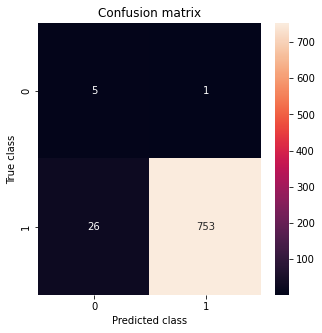

              precision    recall  f1-score   support

           0       0.16      0.83      0.27         6
           1       1.00      0.97      0.98       779

    accuracy                           0.97       785
   macro avg       0.58      0.90      0.63       785
weighted avg       0.99      0.97      0.98       785



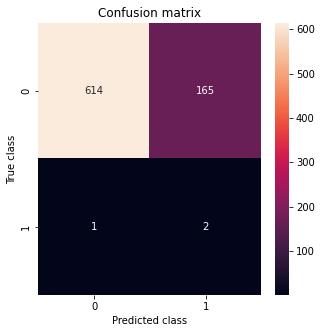

              precision    recall  f1-score   support

           1       1.00      0.79      0.88       779
           2       0.01      0.67      0.02         3

    accuracy                           0.79       782
   macro avg       0.51      0.73      0.45       782
weighted avg       0.99      0.79      0.88       782



In [ ]:
lrc_balanced_3_c = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={0: d_3_c, 1: 1})
lrc_balanced_3_s = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={2: d_3_s, 1: 1})

# Train Logistic Regression Classifer
lrc_model_3_c = lrc_balanced_3_c.fit(X_train_3_c, y_train_3_c)
pickle.dump(lrc_model_3_c, open("lrc_model_3_c.sav", 'wb'))
lrc_model_3_s = lrc_balanced_3_s.fit(X_train_3_s, y_train_3_s)
pickle.dump(lrc_model_3_s, open("lrc_model_3_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_3_c = lrc_model_3_c.predict(X_test_3_c)
y_pred_3_s = lrc_model_3_s.predict(X_test_3_s)

show_results(y_test_3_c, y_pred_3_c)
show_results(y_test_3_s, y_pred_3_s)

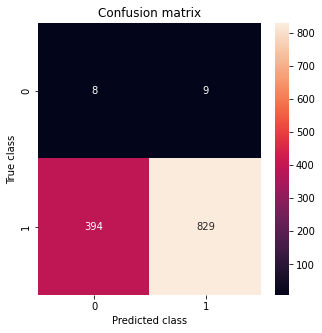

              precision    recall  f1-score   support

           0       0.02      0.47      0.04        17
           1       0.99      0.68      0.80      1223

    accuracy                           0.68      1240
   macro avg       0.50      0.57      0.42      1240
weighted avg       0.98      0.68      0.79      1240



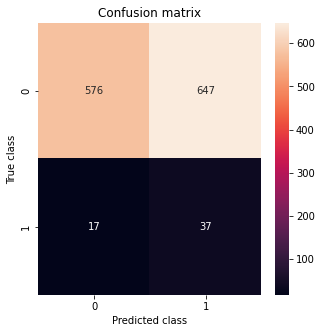

              precision    recall  f1-score   support

           1       0.97      0.47      0.63      1223
           2       0.05      0.69      0.10        54

    accuracy                           0.48      1277
   macro avg       0.51      0.58      0.37      1277
weighted avg       0.93      0.48      0.61      1277



In [ ]:
lrc_balanced_4_c = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={0: d_4_c, 1: 1})
lrc_balanced_4_s = LogisticRegression(solver='lbfgs', max_iter=1000, class_weight={2: d_4_s, 1: 1})

# Train Logistic Regression Classifer
lrc_model_4_c = lrc_balanced_4_c.fit(X_train_4_c, y_train_4_c)
pickle.dump(lrc_model_4_c, open("lrc_model_4_c.sav", 'wb'))
lrc_model_4_s = lrc_balanced_4_s.fit(X_train_4_s, y_train_4_s)
pickle.dump(lrc_model_4_s, open("lrc_model_4_s.sav", 'wb'))

# Predict the response for test dataset
y_pred_4_c = lrc_model_4_c.predict(X_test_4_c)
y_pred_4_s = lrc_model_4_s.predict(X_test_4_s)

show_results(y_test_4_c, y_pred_4_c)
show_results(y_test_4_s, y_pred_4_s)

# Aprendizaje automático - Predicción

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LeakyReLU, Activation, Dropout, LSTM, TimeDistributed

In [ ]:
basicInfo = ucip.iloc[:, [0, 7, 8, 9, 10, 13, 14]]
print(basicInfo)

       Id   Time   FC  SpO2  FR  TAM  Condition
0       1  18:52  138    92  36   73          1
1       1  18:53  142    92  31   69          1
2       1  18:54  139    92  31   68          1
3       1  18:55  142    92  29   66          1
4       1  18:56  144    92  25   71          1
...    ..    ...  ...   ...  ..  ...        ...
94673  90   7:40  105    78   0   37          1
94674  90   7:41  105    78   0   37          1
94675  90   7:42   40    60   0    0          1
94676  90   7:43   20    30   0    0          1
94677  90   7:44   20     0   0    0          1

[94241 rows x 7 columns]


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fbc243af940>,
      dtype=object)

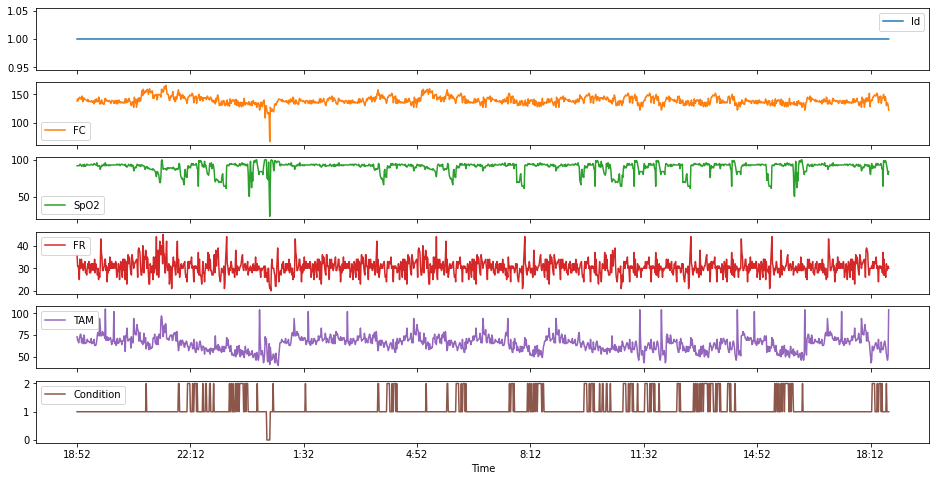

In [ ]:
df1 = basicInfo.loc[basicInfo['Id'] == 1]
df1.plot(x="Time", figsize=(16, 8), subplots=True)

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fbc24202640>,
      dtype=object)

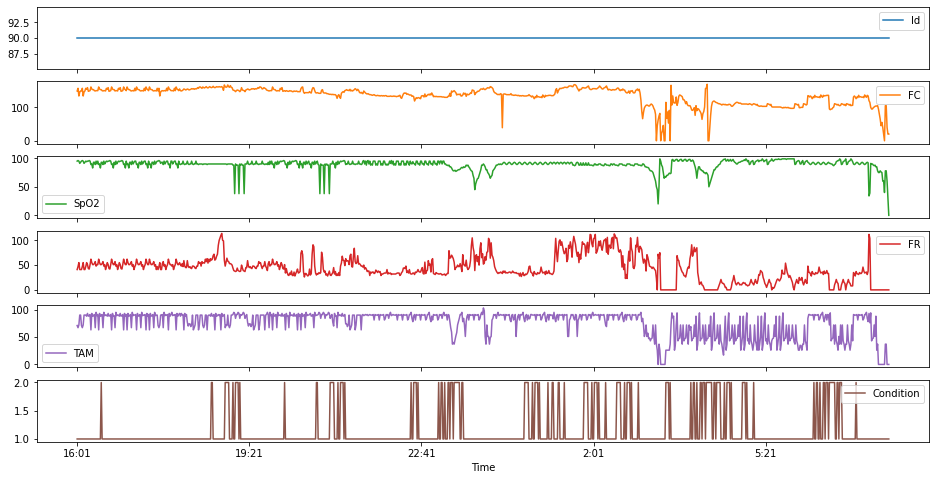

In [ ]:
df90 = basicInfo.loc[basicInfo['Id'] == 90]
df90.plot(x="Time", figsize=(16, 8), subplots=True)

In [ ]:
# Function to create train data
def create_train_data(df, look_back):
    dataX1, dataX2 = [], []
    for i in range(len(df)-look_back-1):
        dataX1.append(df.iloc[i : i + look_back, 0:4].values)
        dataX2.append(df.iloc[i : i + look_back, 4].values)
        
    return np.array(dataX1), np.array(dataX2)

# Function to create test data
def create_test_data(df, look_back):
    dataX1, dataX2 = [], []
    for i in range(len(df)-look_back-1):
        dataX1.append(df.iloc[i : i + look_back, 0:4].values)
        dataX2.append(df.iloc[i : i + look_back, 4].values)
        
    return np.array(dataX1), np.array(dataX2)

Pacientes - Grupo 1

In [ ]:
from collections import Counter
from sklearn.datasets import make_classification
from imblearn.over_sampling import SMOTE

df_group_1 = ucip_group_1
ids = df_group_1['Id'].unique()

train_group_1 = pd.DataFrame()
test_group_1 = pd.DataFrame()

counter = 1
for id in ids:
  dataset = df_group_1.loc[df_group_1['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)
  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_1 = train_group_1.append(subtrain)
  test_group_1 = test_group_1.append(subtest)
  counter = counter + 1

print("Patients in Group 1: ", counter)

# Aplica el método SMOTE
sm = SMOTE(random_state=42)
x_train_a = train_group_1.iloc[:, 0:4]
y_train_a = train_group_1.iloc[:, 4]
X_res_group_1, y_res_group_1 = sm.fit_resample(x_train_a, y_train_a)
new_train_group_1 = X_res_group_1.join(y_res_group_1)

x_group_1, y_group_1 = create_train_data(new_train_group_1, 5)
test_x_group_1, test_y_group_1 = create_test_data(test_group_1, 1)

Patients in Group 1:  61


In [ ]:
model_g1 = Sequential()
model_g1.add(LSTM(32, input_shape=(None, 4)))
model_g1.add(Dense(units=1, activation='linear'))
model_g1.add(LeakyReLU())
model_g1.compile(optimizer='adam', loss='mean_squared_error')
model_g1.fit(x_group_1, y_group_1, epochs=30, batch_size=8)

model_g1.save('lstm_model_group_1.h5')

Epoch 1/30
16747/16747 [==============================] - 59s 3ms/step - loss: 0.2772
Epoch 2/30
16747/16747 [==============================] - 57s 3ms/step - loss: 0.2255
Epoch 3/30
16747/16747 [==============================] - 57s 3ms/step - loss: 0.2144
Epoch 4/30
16747/16747 [==============================] - 58s 3ms/step - loss: 0.2069
Epoch 5/30
16747/16747 [==============================] - 58s 3ms/step - loss: 0.2004
Epoch 6/30
16747/16747 [==============================] - 57s 3ms/step - loss: 0.1950
Epoch 7/30
16747/16747 [==============================] - 63s 4ms/step - loss: 0.1900
Epoch 8/30
16747/16747 [==============================] - 60s 4ms/step - loss: 0.1871
Epoch 9/30
16747/16747 [==============================] - 60s 4ms/step - loss: 0.1854
Epoch 10/30
16747/16747 [==============================] - 62s 4ms/step - loss: 0.1810
Epoch 11/30
16747/16747 [==============================] - 59s 4ms/step - loss: 0.1800
Epoch 12/30
16747/16747 [===========================

In [ ]:
print("Resultados Grupo 1")

accuracy = 0
for id in ids:
  dataset = df_group_1.loc[df_group_1['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]

  testX, testY = create_test_data(test, 1)

  predicted = model_g1.predict(testX)
  predicted = (abs( predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_lstm_g1 = round(accuracy, 2)

Resultados Grupo 1
14/14 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  0.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 1 :  73.3644859813084 %
14/14 [==============================] - 0s 1ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  0.0 1.0
Minuto  20 :  0.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  0.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 2 :  67.49435665914221 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  0.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 0.0
Paciente 3 :  81.203007518797 %
14/14 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :

Pacientes - Grupo 2

In [ ]:
df_group_2 = ucip_group_2
ids = df_group_2['Id'].unique()

train_group_2 = pd.DataFrame()
test_group_2 = pd.DataFrame()

counter = 1
for id in ids:
  dataset = df_group_2.loc[df_group_2['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_2 = train_group_2.append(subtrain)
  test_group_2 = test_group_2.append(subtest)
  counter = counter + 1

print("Patients in Group 2: ", counter)

x_group_2, y_group_2 = create_train_data(train_group_2, 5)
test_x_group_2, test_y_group_2 = create_test_data(test_group_2, 1)

Patients in Group 2:  18


In [ ]:
model_g2 = Sequential()
model_g2.add(LSTM(32, input_shape=(None, 4)))
model_g2.add(Dense(units=1, activation='linear'))
model_g2.add(LeakyReLU())
model_g2.compile(optimizer='adam', loss='mean_squared_error')
model_g2.fit(x_group_2, y_group_2, epochs=30, batch_size=8)

model_g2.save('lstm_model_group_2.h5')

Epoch 1/30
909/909 [==============================] - 5s 4ms/step - loss: 0.1044
Epoch 2/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0970
Epoch 3/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0957
Epoch 4/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0954
Epoch 5/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0946
Epoch 6/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0945
Epoch 7/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0943
Epoch 8/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0940
Epoch 9/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0934
Epoch 10/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0934
Epoch 11/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0928
Epoch 12/30
909/909 [==============================] - 3s 4ms/step - loss: 0.0930
Epoch 13/30
909/909 [====

In [ ]:
print("Resultados Grupo 2")

accuracy = 0
for id in ids:
  dataset = df_group_2.loc[df_group_2['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]

  testX, testY = create_test_data(test, 1)

  predicted = model_g2.predict(testX)
  predicted = (abs( predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_lstm_g2 = round(accuracy, 2)

Resultados Grupo 2
4/4 [==============================] - 0s 4ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 0.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 4 :  98.30508474576271 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 9 :  100.0 %
4/4 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 0.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 16 :  98.30508474576271 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minu

Pacientes - Grupo 3

In [ ]:
df_group_3 = ucip_group_3
ids = df_group_3['Id'].unique()

train_group_3 = pd.DataFrame()
test_group_3 = pd.DataFrame()

counter = 1
for id in ids:
  dataset = df_group_3.loc[df_group_3['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_3 = train_group_3.append(subtrain)
  test_group_3 = test_group_3.append(subtest)
  counter = counter + 1

print("Patients in Group 3: ", counter)

x_group_3, y_group_3 = create_train_data(train_group_3, 10)
test_x_group_3, test_y_group_3 = create_test_data(test_group_3, 1)

Patients in Group 3:  4


In [ ]:
model_g3 = Sequential()
model_g3.add(LSTM(32, input_shape=(None, 4)))
model_g3.add(Dense(units=1, activation='linear'))
model_g3.add(LeakyReLU())
model_g3.compile(optimizer='adam', loss='mean_squared_error')
model_g3.fit(x_group_3, y_group_3, epochs=30, batch_size=8)

model_g3.save('lstm_model_group_3.h5')

Epoch 1/30
228/228 [==============================] - 4s 6ms/step - loss: 0.0616
Epoch 2/30
228/228 [==============================] - 1s 5ms/step - loss: 0.0124
Epoch 3/30
228/228 [==============================] - 1s 5ms/step - loss: 0.0116
Epoch 4/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0113
Epoch 5/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0112
Epoch 6/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0112
Epoch 7/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0111
Epoch 8/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0111
Epoch 9/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0109
Epoch 10/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0108
Epoch 11/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0108
Epoch 12/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0110
Epoch 13/30
228/228 [====

In [ ]:
print("Resultados Grupo 3")

accuracy = 0
for id in ids:
  dataset = df_group_3.loc[df_group_3['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]

  testX, testY = create_test_data(test, 1)

  predicted = model_g3.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_lstm_g3 = round(accuracy, 2)

Resultados Grupo 3
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 8 :  99.2156862745098 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 44 :  94.8339483394834 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 75 :  98.046875 %



=== Accuracy Score ===
Accuracy Score 97.37 %


Pacientes - Grupo 4

In [ ]:
df_group_4 = ucip_group_4
ids = df_group_4['Id'].unique()

train_group_4 = pd.DataFrame()
test_group_4 = pd.DataFrame()

counter = 1
for id in ids:

  dataset = df_group_4.loc[df_group_4['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_4 = train_group_4.append(subtrain)
  test_group_4 = test_group_4.append(subtest)
  counter = counter + 1

print("Patients in Group 4: ", counter)

x_group_4, y_group_4 = create_train_data(train_group_4, 10)
test_x_group_4, test_y_group_4 = create_test_data(test_group_4, 1)

Patients in Group 4:  6


In [ ]:
model_g4 = Sequential()
model_g4.add(LSTM(32, input_shape=(None, 4)))
model_g4.add(Dense(units=1, activation='linear'))
model_g4.add(LeakyReLU())
model_g4.compile(optimizer='adam', loss='mean_squared_error')
model_g4.fit(x_group_4, y_group_4, epochs=30, batch_size=8)

model_g4.save('lstm_model_group_4.h5')

Epoch 1/30
376/376 [==============================] - 4s 5ms/step - loss: 0.0996
Epoch 2/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0626
Epoch 3/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0620
Epoch 4/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0618
Epoch 5/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0617
Epoch 6/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0615
Epoch 7/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0616
Epoch 8/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0616
Epoch 9/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0613
Epoch 10/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0612
Epoch 11/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0615
Epoch 12/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0612
Epoch 13/30
376/376 [====

In [ ]:
print("Resultados Grupo 4")

accuracy = 0
for id in ids:
  dataset = df_group_4.loc[df_group_4['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]

  testX, testY = create_test_data(test, 1)

  predicted = model_g4.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_lstm_g4 = round(accuracy, 2)

Resultados Grupo 4
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 20 :  97.265625 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 32 :  94.07407407407408 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 37 :  98.72340425531915 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.

In [ ]:
from keras.layers import GRU

Pacientes - Grupo 1

In [ ]:
df_group_1 = ucip_group_1
ids = df_group_1['Id'].unique()

train_group_1 = pd.DataFrame()
test_group_1 = pd.DataFrame()

counter = 1
for id in ids:

  dataset = df_group_1.loc[df_group_1['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_1 = train_group_1.append(subtrain)
  test_group_1 = test_group_1.append(subtest)
  counter = counter + 1

x_group_1, y_group_1 = create_train_data(train_group_1, 10)
test_x_group_1, test_y_group_1 = create_test_data(test_group_1, 1)

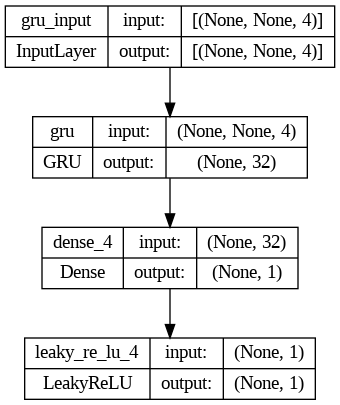

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.utils.vis_utils import plot_model

plot_model(model_gru_g1, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
model_gru_g1 = Sequential()
model_gru_g1.add(GRU(32, input_shape=(None, 4)))
model_gru_g1.add(Dense(units=1, activation='linear'))
model_gru_g1.add(LeakyReLU())
model_gru_g1.compile(optimizer='adam', loss='mean_squared_error')
model_gru_g1.fit(x_group_1, y_group_1, epochs=30, batch_size=8)

model_gru_g1.save('gru_model_group_1.h5')

Epoch 1/30
6365/6365 [==============================] - 39s 6ms/step - loss: 0.1231
Epoch 2/30
6365/6365 [==============================] - 34s 5ms/step - loss: 0.1090
Epoch 3/30
6365/6365 [==============================] - 34s 5ms/step - loss: 0.1081
Epoch 4/30
6365/6365 [==============================] - 37s 6ms/step - loss: 0.1079
Epoch 5/30
6365/6365 [==============================] - 35s 5ms/step - loss: 0.1076
Epoch 6/30
6365/6365 [==============================] - 35s 6ms/step - loss: 0.1076
Epoch 7/30
6365/6365 [==============================] - 36s 6ms/step - loss: 0.1076
Epoch 8/30
6365/6365 [==============================] - 38s 6ms/step - loss: 0.1071
Epoch 9/30
6365/6365 [==============================] - 36s 6ms/step - loss: 0.1070
Epoch 10/30
6365/6365 [==============================] - 35s 6ms/step - loss: 0.1067
Epoch 11/30
6365/6365 [==============================] - 35s 6ms/step - loss: 0.1067
Epoch 12/30
6365/6365 [==============================] - 36s 6ms/step - lo

In [ ]:
print("Resultados Grupo 1")

accuracy = 0
for id in ids:
  dataset = df_group_1.loc[df_group_1['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]
  
  testX, testY = create_test_data(test, 1)

  predicted = model_gru_g1.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_gru_g1 = round(accuracy, 2)

Resultados Grupo 1
14/14 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 1 :  80.14018691588785 %
14/14 [==============================] - 0s 1ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 2 :  94.80812641083521 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 0.0
Paciente 3 :  79.69924812030075 %
14/14 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  4

Pacientes - Grupo 2

In [ ]:
df_group_2 = ucip_group_2
ids = df_group_2['Id'].unique()

train_group_2 = pd.DataFrame()
test_group_2 = pd.DataFrame()

counter = 1
for id in ids:

  dataset = df_group_2.loc[df_group_2['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_2 = train_group_2.append(subtrain)
  test_group_2 = test_group_2.append(subtest)
  counter = counter + 1

x_group_2, y_group_2 = create_train_data(train_group_2, 10)
test_x_group_2, test_y_group_2 = create_test_data(test_group_2, 1)

In [ ]:
model_gru_g2 = Sequential()
model_gru_g2.add(GRU(32, input_shape=(None, 4)))
model_gru_g2.add(Dense(units=1, activation='linear'))
model_gru_g2.add(LeakyReLU())
model_gru_g2.compile(optimizer='adam', loss='mean_squared_error')
model_gru_g2.fit(x_group_2, y_group_2, epochs=30, batch_size=8)

model_gru_g2.save('gru_model_group_2.h5')

Epoch 1/30
908/908 [==============================] - 7s 5ms/step - loss: 0.1297
Epoch 2/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0970
Epoch 3/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0957
Epoch 4/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0943
Epoch 5/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0935
Epoch 6/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0930
Epoch 7/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0924
Epoch 8/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0952
Epoch 9/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0931
Epoch 10/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0930
Epoch 11/30
908/908 [==============================] - 5s 5ms/step - loss: 0.0926
Epoch 12/30
908/908 [==============================] - 6s 7ms/step - loss: 0.0932
Epoch 13/30
908/908 [====

In [ ]:
print("Resultados Grupo 2")

accuracy = 0
for id in ids:
  dataset = df_group_2.loc[df_group_2['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]
  
  testX, testY = create_test_data(test, 1)

  predicted = model_gru_g2.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_gru_g2 = round(accuracy, 2)

Resultados Grupo 2
4/4 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 0.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 4 :  98.30508474576271 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 9 :  100.0 %
4/4 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 0.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 16 :  98.30508474576271 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minu

Pacientes - Grupo 3

In [ ]:
df_group_3 = ucip_group_3
ids = df_group_3['Id'].unique()

train_group_3 = pd.DataFrame()
test_group_3 = pd.DataFrame()

counter = 1
for id in ids:

  dataset = df_group_3.loc[df_group_3['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_3 = train_group_3.append(subtrain)
  test_group_3 = test_group_3.append(subtest)
  counter = counter + 1

x_group_3, y_group_3 = create_train_data(train_group_3, 10)
test_x_group_3, test_y_group_3 = create_test_data(test_group_3, 1)

In [ ]:
model_gru_g3 = Sequential()
model_gru_g3.add(GRU(32, input_shape=(None, 4)))
model_gru_g3.add(Dense(units=1, activation='linear'))
model_gru_g3.add(LeakyReLU())
model_gru_g3.compile(optimizer='adam', loss='mean_squared_error')
model_gru_g3.fit(x_group_3, y_group_3, epochs=30, batch_size=8)

model_gru_g3.save('gru_model_group_3.h5')

Epoch 1/30
228/228 [==============================] - 2s 4ms/step - loss: 0.0922
Epoch 2/30
228/228 [==============================] - 1s 3ms/step - loss: 0.0179
Epoch 3/30
228/228 [==============================] - 1s 3ms/step - loss: 0.0156
Epoch 4/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0140
Epoch 5/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0122
Epoch 6/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0115
Epoch 7/30
228/228 [==============================] - 1s 3ms/step - loss: 0.0114
Epoch 8/30
228/228 [==============================] - 1s 3ms/step - loss: 0.0111
Epoch 9/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0112
Epoch 10/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0112
Epoch 11/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0108
Epoch 12/30
228/228 [==============================] - 1s 4ms/step - loss: 0.0108
Epoch 13/30
228/228 [====

In [ ]:
print("Resultados Grupo 3")

accuracy = 0
for id in ids:
  dataset = df_group_3.loc[df_group_3['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]
  
  testX, testY = create_test_data(test, 1)

  predicted = model_gru_g3.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_gru_g3 = round(accuracy, 2)

Resultados Grupo 3
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 8 :  90.58823529411765 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 44 :  98.5239852398524 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 75 :  92.578125 %



=== Accuracy Score ===
Accuracy Score 93.9 %


Pacientes - Grupo 4

In [ ]:
df_group_4 = ucip_group_4
ids = df_group_4['Id'].unique()

train_group_4 = pd.DataFrame()
test_group_4 = pd.DataFrame()

counter = 1
for id in ids:

  dataset = df_group_4.loc[df_group_4['Id'] == id]

  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  test_size = len(dataset) - train_size

  if counter % 2 == 0:
    subtrain, subtest = dataset.iloc[len(dataset)-train_size:len(dataset),:], dataset.iloc[0:test_size,:]
  else:
    subtrain, subtest = dataset.iloc[0:train_size,:], dataset.iloc[train_size:,:]

  train_group_4 = train_group_4.append(subtrain)
  test_group_4 = test_group_4.append(subtest)
  counter = counter + 1

x_group_4, y_group_4 = create_train_data(train_group_4, 10)
test_x_group_4, test_y_group_4 = create_test_data(test_group_4, 1)

In [ ]:
model_gru_g4 = Sequential()
model_gru_g4.add(GRU(32, input_shape=(None, 4)))
model_gru_g4.add(Dense(units=1, activation='linear'))
model_gru_g4.add(LeakyReLU())
model_gru_g4.compile(optimizer='adam', loss='mean_squared_error')
model_gru_g4.fit(x_group_4, y_group_4, epochs=30, batch_size=8)

model_gru_g4.save('gru_model_group_4.h5')

Epoch 1/30
376/376 [==============================] - 4s 5ms/step - loss: 0.0911
Epoch 2/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0655
Epoch 3/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0646
Epoch 4/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0626
Epoch 5/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0626
Epoch 6/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0620
Epoch 7/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0619
Epoch 8/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0620
Epoch 9/30
376/376 [==============================] - 2s 6ms/step - loss: 0.0621
Epoch 10/30
376/376 [==============================] - 3s 7ms/step - loss: 0.0620
Epoch 11/30
376/376 [==============================] - 2s 6ms/step - loss: 0.0615
Epoch 12/30
376/376 [==============================] - 2s 5ms/step - loss: 0.0613
Epoch 13/30
376/376 [====

In [ ]:
print("Resultados Grupo 4")

accuracy = 0
for id in ids:
  dataset = df_group_4.loc[df_group_4['Id'] == id]
  dataset.drop('Id', inplace=True, axis=1)
  dataset.drop('Age (months)', inplace=True, axis=1)

  train_size = int(len(dataset) * 0.7)
  train, test = dataset.iloc[0:train_size,:], dataset.iloc[train_size:len(dataset),:]
  
  testX, testY = create_test_data(test, 1)

  predicted = model_gru_g4.predict(testX)
  predicted = (abs(predicted.round())).tolist()

  testY = np.asarray(testY).astype(np.float32)
  testY = (testY.round()).tolist()

  for i in range(len(testY)):
    testY[i] = testY[i][0]

  good = 0
  bad = 0

  for i in range(len(predicted)):
    if predicted[i][0] == testY[i]:
      good = good + 1
    else:
      bad = bad + 1
    if i == 5:
      print("Minuto  05 : ", predicted[i][0], testY[i])
    if i == 10 or i == 15 or i == 20 or i == 25 or i == 30 or i == 45 or i == 60:
      print("Minuto ", i, ": ", predicted[i][0], testY[i])

  print("Paciente", id, ": ", good * 100 / len(predicted), "%")
  accuracy = accuracy + round(good * 100 / len(predicted), 2)

accuracy = accuracy / len(ids)

print("\n\n")
print("=== Accuracy Score ===")
print("Accuracy Score", round(accuracy, 2), "%")
result_gru_g4 = round(accuracy, 2)

Resultados Grupo 4
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 20 :  95.3125 %
9/9 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 32 :  90.37037037037037 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0
Minuto  60 :  1.0 1.0
Paciente 37 :  95.74468085106383 %
8/8 [==============================] - 0s 2ms/step
Minuto  05 :  1.0 1.0
Minuto  10 :  1.0 1.0
Minuto  15 :  1.0 1.0
Minuto  20 :  1.0 1.0
Minuto  25 :  1.0 1.0
Minuto  30 :  1.0 1.0
Minuto  45 :  1.0 1.0


LSTM vs GRU

In [ ]:
print("---------------------------------------")
print("------------- LSTM vs GRU -------------")
print("---------------------------------------")
print("Group 1: LSTM -", "%.2f" % round(result_lstm_g1, 2), "%", "  GRU -", "%.2f" % round(result_gru_g1, 2), "%")
print("Group 2: LSTM -", "%.2f" % round(result_lstm_g2, 2), "%", "  GRU -", "%.2f" % round(result_gru_g2, 2), "%")
print("Group 3: LSTM -", "%.2f" % round(result_lstm_g3, 2), "%", "  GRU -", "%.2f" % round(result_gru_g3, 2), "%")
print("Group 4: LSTM -", "%.2f" % round(result_lstm_g4, 2), "%", "  GRU -", "%.2f" % round(result_gru_g4, 2), "%")

---------------------------------------
------------- LSTM vs GRU -------------
---------------------------------------
Group 1: LSTM - 75.54 %   GRU - 85.56 %
Group 2: LSTM - 83.69 %   GRU - 83.50 %
Group 3: LSTM - 97.37 %   GRU - 93.90 %
Group 4: LSTM - 95.48 %   GRU - 92.61 %
